# Object Detection with SSD
## Load Necessary Package

In [1]:
import os
import sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)

import torch
import torch.nn as nn
import torch.backends.cudnn as cudnn
from torch.autograd import Variable
import numpy as np
import cv2

# if torch.cuda.is_available():
#     torch.set_default_tensor_type('torch.cuda.FloatTensor')

from data import VOCAnnotationTransform, VOCDetection, BaseTransform, VOC_CLASSES
from data import VOC_CLASSES as labels

%matplotlib inline
from matplotlib import pyplot as plt

from ssd import build_ssd
from ssd300_fpn38 import build_ssd300_fpn38
from ssd300_fpn75 import build_ssd300_fpn75
from ssd300_fpn150 import build_ssd300_fpn150

## Load TrainedSSD300 

In [2]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device ='cpu'

net = build_ssd('test', 300, 21)    # initialize SSD
net.load_state_dict(torch.load('../weights/ssd300_mAP_77.43_v2.pth'))

net = net.to(device)
net = net.eval()

# mynet = build_ssd300_fpn38('test', 300, 21)
# mynet.load_state_dict(torch.load('../weights/ssd300_fpn38_78.45.pth'))

# mynet = build_ssd300_fpn75('test', 300, 21)
# mynet.load_state_dict(torch.load('../weights/ssd300_fpn75_78.95.pth'))

mynet = build_ssd300_fpn150('test', 300, 21)
mynet.load_state_dict(torch.load('../weights/ssd300_fpn150_79.03.pth'))

mynet.to(device)
mynet.eval()

pytorch_total_params = sum(p.numel() for p in net.parameters() if p.requires_grad)
print("Total", pytorch_total_params)

pytorch_total_params = sum(p.numel() for p in mynet.parameters() if p.requires_grad)
print("Total", pytorch_total_params)

Total 26285486
Total 41469458


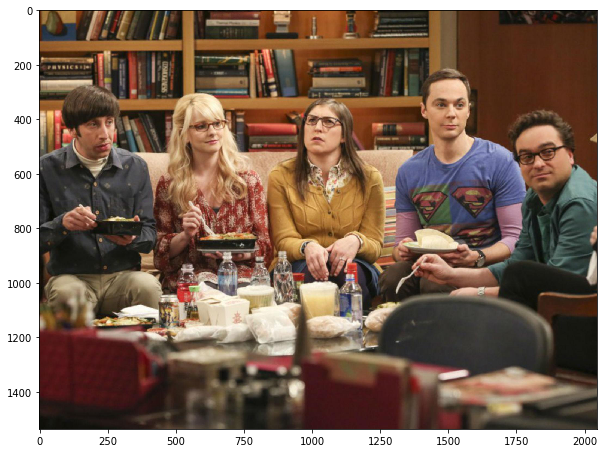

In [3]:
# Load image & show
img = cv2.imread('./demo_imgs/0.png')
# img = cv2.imread('./demo_imgs/1.jpg')
img = cv2.imread('./demo_imgs/2.jpg')
# img = cv2.imread('./demo_imgs/3.jpg')
# img = cv2.imread('./demo_imgs/4.png')
# img = cv2.imread('./demo_imgs/5.jpg')
rgb_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10,10))
plt.imshow(rgb_img)
plt.show()

In [4]:
# Feed into network
transform = BaseTransform(net.size, (104, 117, 123))
x = torch.from_numpy(transform(img)[0]).permute(2, 0, 1)
x = Variable(x.unsqueeze(0))
x = x.to(device)

tensor([2048., 1536., 2048., 1536.])


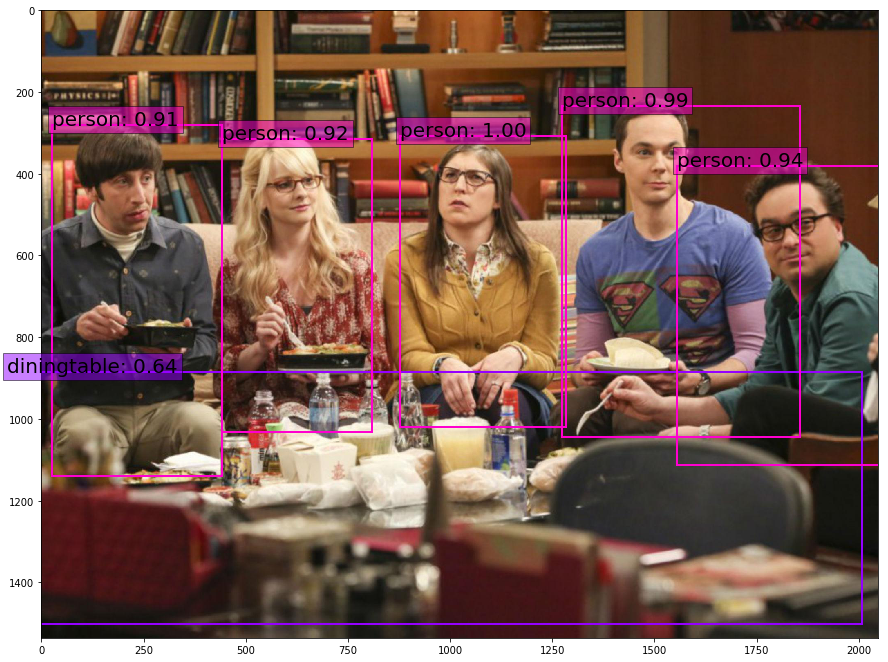

In [5]:
# Plot the detected bounding box\
y = mynet(x)
detections = y.data # detections = [num_imgs, classes, top200, (conf, x, y, w, h)]

top_k=10# only display top_k bbox for one class
threshold = 0.6
plt.figure(figsize=(15,15))
colors = plt.cm.hsv(np.linspace(0.5, 1, 21)).tolist()
plt.imshow(rgb_img)  # plot the image for matplotlib
currentAxis = plt.gca()


# scale each detection back up to the image

scale = torch.Tensor(rgb_img.shape[1::-1]).repeat(2)
print(scale)
for i in range(detections.size(1)):
    j = 0
    while detections[0,i,j,0] >= threshold:
        score = detections[0,i,j,0]
        label_name = labels[i-1]
        display_txt = '%s: %.2f'%(label_name, score)
        pt = (detections[0,i,j,1:]*scale).cpu().numpy() # scale back to origin image
        coords = (pt[0], pt[1]), pt[2]-pt[0]+1, pt[3]-pt[1]+1
        color = colors[i]
        currentAxis.add_patch(plt.Rectangle(*coords, fill=False, edgecolor=color, linewidth=2))
        currentAxis.text(pt[0], pt[1], display_txt, bbox={'facecolor':color, 'alpha':0.5}, fontsize=20)
        j+=1
        if j > top_k-1:
            break

tensor([2048., 1536., 2048., 1536.])


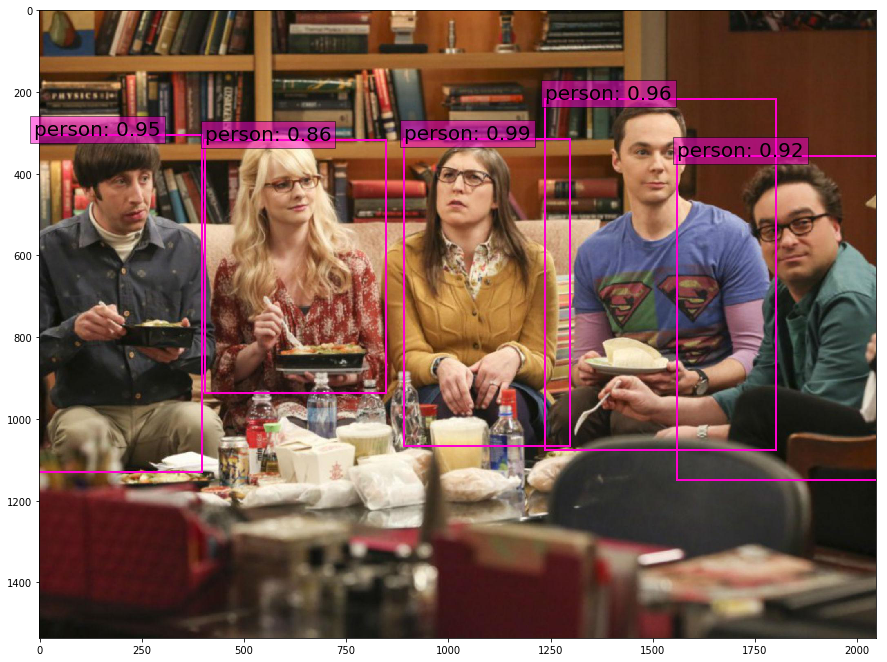

In [6]:
# Plot the detected bounding box\
y = net(x)
detections = y.data # detections = [num_imgs, classes, top200, (conf, x, y, w, h)]

top_k=10  # only display top_k bbox for one class
threshold = 0.6
plt.figure(figsize=(15,15))
colors = plt.cm.hsv(np.linspace(0.5, 1, 21)).tolist()
plt.imshow(rgb_img)  # plot the image for matplotlib
currentAxis = plt.gca()
# scale each detection back up to the image

scale = torch.Tensor(rgb_img.shape[1::-1]).repeat(2)
print(scale)
for i in range(detections.size(1)):
    j = 0
    while detections[0,i,j,0] >= threshold:
        score = detections[0,i,j,0]
        label_name = labels[i-1]
        display_txt = '%s: %.2f'%(label_name, score)
        pt = (detections[0,i,j,1:]*scale).cpu().numpy() # scale back to origin image
        coords = (pt[0], pt[1]), pt[2]-pt[0]+1, pt[3]-pt[1]+1
        color = colors[i]
        currentAxis.add_patch(plt.Rectangle(*coords, fill=False, edgecolor=color, linewidth=2))
        currentAxis.text(pt[0], pt[1], display_txt, bbox={'facecolor':color, 'alpha':0.5}, fontsize=20)
        j+=1
        if j > top_k-1:
            break

In [41]:
def preprocessing(img):
    transform = BaseTransform(300, (104, 117, 123))
    x = torch.from_numpy(transform(img)[0]).permute(2, 0, 1)
    x = Variable(x.unsqueeze(0))
    x = x.to(device)
    return x

def plot_annotation(detections, rgb_img, topk=10, threshold=0.6, target=None, color=None, label=None):
    colors = plt.cm.hsv(np.linspace(0.5, 1, 21)).tolist()
    currentAxis = plt.gca()
    scale = torch.Tensor(rgb_img.shape[1::-1]).repeat(2)
    m = 0
    for i in range(detections.size(1)):
        j = 0
        while detections[0,i,j,0] >= threshold:
            score = detections[0,i,j,0]
            label_name = labels[i-1]
            if target is None or label_name == target:
                display_txt = '%s: %.2f'%(label_name, score) if label is None else label
                pt = (detections[0,i,j,1:]*scale).cpu().numpy() # scale back to origin image
                coords = (pt[0], pt[1]), pt[2]-pt[0]+1, pt[3]-pt[1]+1
                if color is None:
                    color = colors[i]
                currentAxis.add_patch(plt.Rectangle(*coords, fill=False, edgecolor=color, linewidth=2))
                #currentAxis.text(pt[0], pt[1], display_txt, bbox={'facecolor':color, 'alpha':0.5}, fontsize=20)
                j+=1
                if j > top_k-1:
                    break
            else:
                j+=1
        m = max(m, j)
    return m

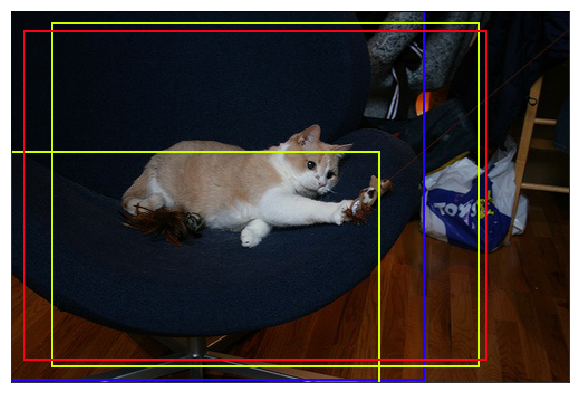

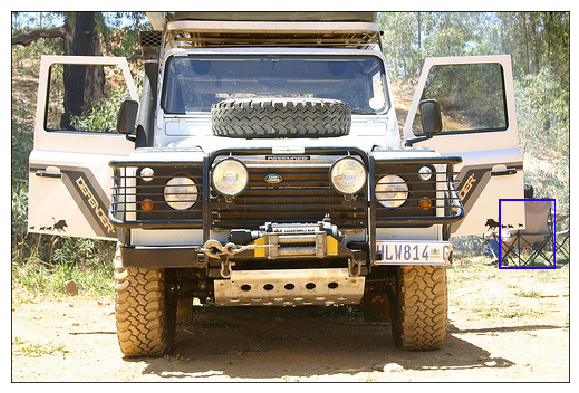

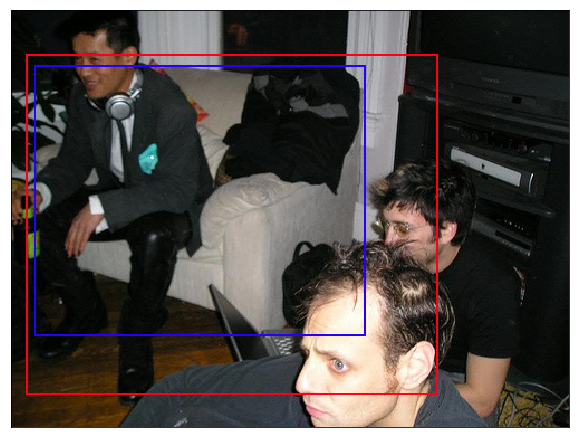

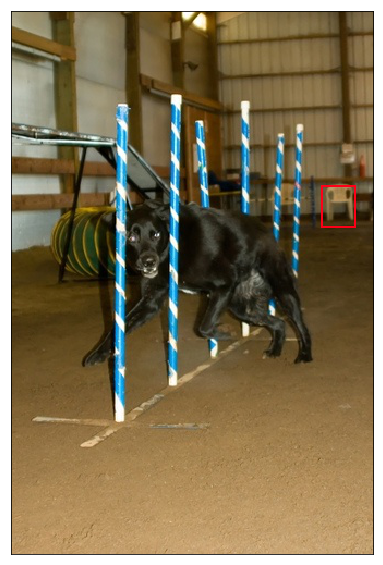

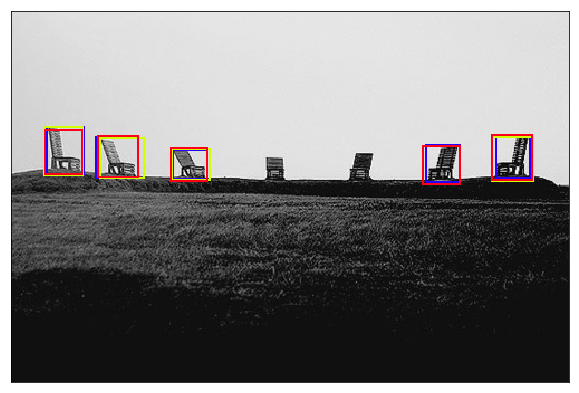

...

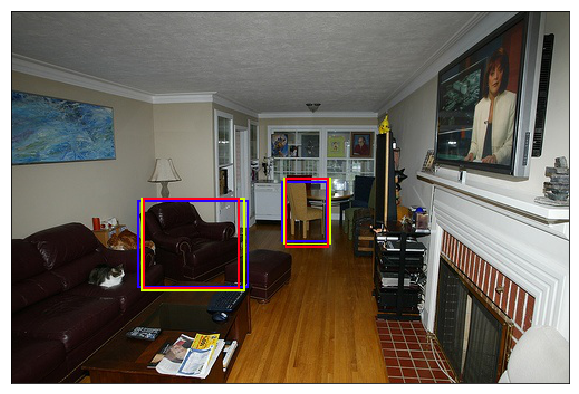

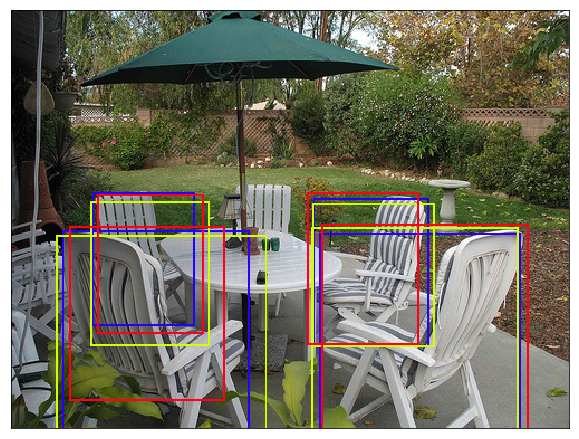

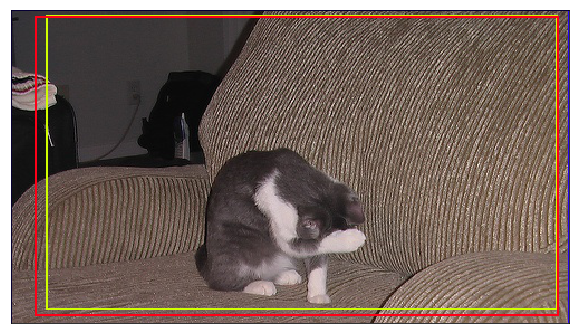

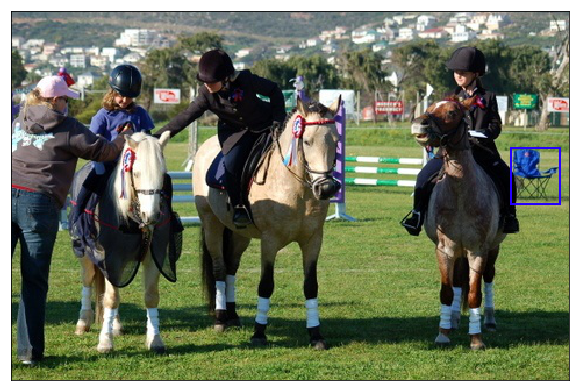

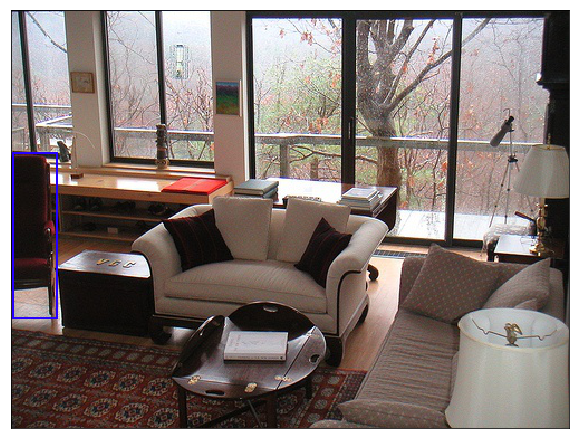

In [43]:
# image = cv2.imread('./data/example.jpg', cv2.IMREAD_COLOR)  # uncomment if dataset not downloaded
%matplotlib inline
from matplotlib import pyplot as plt
from data import VOCDetection, VOC_ROOT, VOCAnnotationTransform
# here we specify year (07 or 12) and dataset ('test', 'val', 'train') 
testset = VOCDetection(VOC_ROOT, [('2007', 'train')], None, VOCAnnotationTransform())

colors = plt.cm.hsv(np.linspace(0, 1, 21)).tolist()

for id in range(0, 1000, 1):
    img_id = id
    image = testset.pull_image(img_id)
    img_id, annotation = testset.pull_anno(img_id)

    # If don't have target, quit
    target = 'chair'
    have_target = False
    for ann in annotation:
        label = labels[ann[4]]
        if label == target:
            have_target = True
    if not have_target:
        continue

    # Show RGB image
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10,10))
    plt.imshow(rgb_image), plt.xticks([]), plt.yticks([])
        
        
    # Draw the ground truth bounding box
    currentAxis = plt.gca()
    for ann in annotation:
        label = labels[ann[4]]
        if label == target:
            pt = ann[:4]
            coords = (pt[0], pt[1]), pt[2]-pt[0]+1, pt[3]-pt[1]+1
            color = colors[14]
            currentAxis.add_patch(plt.Rectangle(*coords, fill=False, edgecolor=color, linewidth=2)) # Blue
            #currentAxis.text(pt[0], pt[1], 'GT', bbox={'facecolor':color, 'alpha':0.5}, fontsize=20)
    
    x = preprocessing(image)
    y_ssd = net(x)
    y_myssd = mynet(x)
    m1 = plot_annotation(y_ssd.data, rgb_image, topk=10, threshold=0.6, target=target, color=colors[4], label='ssd') # yellow
    m2 = plot_annotation(y_myssd.data, rgb_image, topk=10, threshold=0.6, target=target, color=colors[20], label='ssd_fpn') # Red 
    if True:
        plt.show()
    else:
        fig = plt.gcf()
        fig.set_size_inches(0.1, 0.1)
        plt.clf()
        plt.show()